In [1]:
import torch
import os
import warmup_scheduler
import tqdm
import numpy as np
import fucs
import config
# from torch.utils.tensorboard import SummaryWriter
from unetlite import UNetLite
from unet_model import UNet
from fucs import save_image
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import pearsonr
import observe_norm
from unetlitefilm import UNetLiteFiLM
from unetlitefilm_3D import UNetLiteFiLM as UNetLiteFiLM_3D
from Unet2 import prepare_data as prepare_data2
from Unet3 import prepare_data as prepare_data3
from Unet3_3D import prepare_data as prepare_data3_3D
from torch.utils.data import TensorDataset, DataLoader
from Unet3 import compute_pcs_from_sst
import seaborn as sns
import torch.nn.functional as F
%load_ext autoreload
%autoreload 1
%aimport config
%aimport fucs
%config InlineBackend.figure_format = 'svg'

In [3]:
train_set, test_set = prepare_data3_3D()

train_loader = DataLoader(
    train_set, batch_size=config.modelconfig["batch_size"],
    shuffle=False, num_workers=0, pin_memory=True
)
test_loader = DataLoader(
    test_set, batch_size=config.modelconfig["batch_size"],
    shuffle=False, num_workers=0, pin_memory=True
)

input_channels = train_set[0][1].shape[0]  # condition channels
index_dim = train_set[0][3].shape[0]       # PCs dimension (n_pcs * window)

with torch.no_grad():
    device = torch.device(config.modelconfig['device'])
    model = UNetLiteFiLM_3D(
        n_channels=60,
        n_classes=6,
        index_dim=index_dim,
        base_filters=32,
        dropout=0.2
    ).to(device)
    ckpt = torch.load(
        os.path.join(config.modelconfig['save_weight_path'], "epoch_425.pt"),
        map_location=device, weights_only=False
    )
    model = ckpt
    model.eval()

Loaded SST shape: (366, 6, 89, 180)
PCA done. Explained variance=0.430


In [4]:
#unet3_3D
output_list = []
x0_list = []
with torch.no_grad():
    for x_0, cond, mask, pcs in tqdm.tqdm(train_loader):
        x_0, cond, mask, pcs = x_0.to(device), cond.to(device), mask.to(device), pcs.to(device)
        B, C, t, H, W = cond.shape
        cond = cond.view(B, t*C, H, W)
        x_0 = x_0.view(B, t, H, W)
        mask = mask.view(B, t, H, W)

        
        output = model(cond, pcs)
        output[mask] = float('nan')
        output_list.append(output)
        x0_list.append(x_0)

with torch.no_grad():
    for x_0, cond, mask, pcs in tqdm.tqdm(test_loader):
        x_0, cond, mask, pcs = x_0.to(device), cond.to(device), mask.to(device), pcs.to(device)
        
        B, C, t, H, W = cond.shape
        cond = cond.view(B, t*C, H, W)
        x_0 = x_0.view(B, t, H, W)
        mask = mask.view(B, t, H, W)
        
        output = model(cond, pcs)
        output[mask] = float('nan')
        output_list.append(output)
        x0_list.append(x_0)

output_all = torch.cat(output_list, dim=0)
x0_all = torch.cat(x0_list, dim=0)
for i in range(6):
    acc = fucs.cal_acc(torch.tensor(x0_all[:,i]).squeeze(1), torch.tensor(output_all[:,i]).squeeze(1))
    print(acc[0:-21].mean(),acc[-21:].mean())


100%|██████████| 2/2 [00:00<00:00, 17.28it/s]
C:\Users\fired\AppData\Local\Temp\ipykernel_29800\3387746168.py:35: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  acc = fucs.cal_acc(torch.tensor(x0_all[:,i]).squeeze(1), torch.tensor(output_all[:,i]).squeeze(1))


tensor(0.3118, device='cuda:0') tensor(0.1813, device='cuda:0')
tensor(0.2164, device='cuda:0') tensor(0.0591, device='cuda:0')
tensor(0.2237, device='cuda:0') tensor(0.0452, device='cuda:0')
tensor(0.2151, device='cuda:0') tensor(0.1208, device='cuda:0')
tensor(0.2174, device='cuda:0') tensor(0.0861, device='cuda:0')
tensor(0.1580, device='cuda:0') tensor(0.0297, device='cuda:0')


In [5]:
np.save(r'E:\D1\diffusion\my_models\UNet_3D_data\output.npy', output_all.cpu().numpy())
np.save(r'E:\D1\diffusion\my_models\UNet_3D_data\x0.npy', x0_all.cpu().numpy())


#### 评估UNet3

In [2]:
train_set, test_set = prepare_data3()

train_loader = DataLoader(
    train_set, batch_size=config.modelconfig["batch_size"],
    shuffle=False, num_workers=0, pin_memory=True
)
test_loader = DataLoader(
    test_set, batch_size=config.modelconfig["batch_size"],
    shuffle=False, num_workers=0, pin_memory=True
)

input_channels = train_set[0][1].shape[0]  # condition channels
index_dim = train_set[0][3].shape[0]       # PCs dimension (n_pcs * window)

with torch.no_grad():
    device = torch.device(config.modelconfig['device'])
    model = UNetLiteFiLM(
        n_channels=10,
        n_classes=1,
        index_dim=index_dim,
        base_filters=16,
        dropout=0.2
    ).to(device)
    ckpt = torch.load(
        os.path.join(r"E:\D1\diffusion\my_models\UNet_data\train_weight_unet3_npcs5", "epoch_160.pt"),
        map_location=device
    )
    model.load_state_dict(ckpt)
    model.to(device)
    model.eval()

Reshaped 5D condition: (361, 60, 120, 140)
Loaded SST shape: (366, 6, 89, 180)
Averaged month-dim: (366, 89, 180)
PCA done. Explained variance=0.555
After windowing: (364, 15)


e:\D1\diffusion\my_models\my_model\Unet3.py:26: RuntimeWarning: Mean of empty slice
  sst_mean = np.nanmean(sst, axis=0, keepdims=True)


In [4]:
all_gamma, all_beta = [], []

# hook 函数：在 forward 时捕获 IndexEncoder 输出
def hook_film_output(module, input, output):
    gammas, betas = output
    # 每层的输出是 [B, C]
    all_gamma.append([g.detach().cpu().numpy() for g in gammas])
    all_beta.append([b.detach().cpu().numpy() for b in betas])

# ✅ 注意：模块名称是 index_encoder（小写）
model.index_encoder.register_forward_hook(hook_film_output)

# -----------------------
# 推理阶段：遍历所有 batch
# -----------------------
with torch.no_grad():
    for x_0, cond, mask, pcs in tqdm.tqdm(train_loader):
        x_0, cond, mask, pcs = (
            x_0.to(device),
            cond.to(device),
            mask.to(device),
            pcs.to(device),
        )
        output0 = model(cond, pcs)
        # output[mask] = float("nan")

# -----------------------
# 合并所有 batch，确保形状统一
# -----------------------

# all_gamma: [n_layers][n_batches][batch_size, n_channels]
n_layers = len(all_gamma[0])  # 例如5层
layer_wise_gamma = [[] for _ in range(n_layers)]#layer_wise_gamma是一个大列表，里面有5个列表，每层一个
layer_wise_beta = [[] for _ in range(n_layers)]

for batch_gammas, batch_betas in zip(all_gamma, all_beta):
    for l in range(n_layers):
        layer_wise_gamma[l].append(batch_gammas[l])  # shape: (B, C)每层里面有5个模态
        layer_wise_beta[l].append(batch_betas[l])    # shape: (B, C)

# ✅ 逐层拼接，允许最后一批样本数不同（注意：不同层的 channel 数可能不同，不能直接 stack）
# 对每一层分别做 concat，保存为逐层数组列表
gamma_per_layer = [np.concatenate(layer_wise_gamma[l], axis=0) for l in range(n_layers)]
beta_per_layer = [np.concatenate(layer_wise_beta[l], axis=0) for l in range(n_layers)]

# 打印每层的形状（不同层 channel 数可能不同，所以展示逐层 shape）
for i, g in enumerate(gamma_per_layer):
    print(f"gamma layer {i} shape: {g.shape}")
for i, b in enumerate(beta_per_layer):
    print(f"beta layer {i} shape: {b.shape}")

# 将每一层以不同键保存到一个 npz 文件中，方便后续逐层读取和分析
# np.savez(
#     r'E:\\D1\\diffusion\\my_models\\my_model_data\\film_dynamic_params_per_layer.npz',
#     **{f'gamma_l{idx}': arr for idx, arr in enumerate(gamma_per_layer)},
#     **{f'beta_l{idx}': arr for idx, arr in enumerate(beta_per_layer)},
# )
# print("Saved per-layer FiLM params to film_dynamic_params_per_layer.npz")

100%|██████████| 11/11 [00:01<00:00, 10.74it/s]

gamma layer 0 shape: (345, 16)
gamma layer 1 shape: (345, 32)
gamma layer 2 shape: (345, 64)
gamma layer 3 shape: (345, 128)
gamma layer 4 shape: (345, 128)
beta layer 0 shape: (345, 16)
beta layer 1 shape: (345, 32)
beta layer 2 shape: (345, 64)
beta layer 3 shape: (345, 128)
beta layer 4 shape: (345, 128)


In [5]:
sst_path = config.modelconfig["sst_file"]
n_pcs = config.modelconfig["n_pcs"]
window = config.modelconfig["pc_window"]
step = config.modelconfig["pc_step"]
pcs, eof_patterns = compute_pcs_from_sst(sst_path, n_pcs=n_pcs, window=window, step=step)
pearsonr(gamma_per_layer[0][:,0], pcs[0:345,0])#第0个下采样层的第0个channel 与 第0个模态的第0个PC的相关系数

e:\D1\diffusion\my_models\my_model\Unet3.py:26: RuntimeWarning: Mean of empty slice
  sst_mean = np.nanmean(sst, axis=0, keepdims=True)


Loaded SST shape: (366, 6, 89, 180)
Averaged month-dim: (366, 89, 180)
PCA done. Explained variance=0.555
After windowing: (366, 5)


PearsonRResult(statistic=np.float32(0.83654267), pvalue=np.float64(1.2190082651003784e-91))

In [6]:
corr_gamma = [np.zeros((16, 5)), np.zeros((32, 5)), np.zeros((64, 5)), np.zeros((128, 5)), np.zeros((128, 5))]
for k in range(len(corr_gamma)):
    for i in range(corr_gamma[k].shape[0]):
        for j in range(5):
            corr_gamma[k][i,j] = pearsonr(gamma_per_layer[k][:,i], pcs[0:345,j])[0]

corr_beta = [np.zeros((16, 5)), np.zeros((32, 5)), np.zeros((64, 5)), np.zeros((128, 5)), np.zeros((128, 5))]
for k in range(len(corr_beta)):
    for i in range(corr_beta[k].shape[0]):
        for j in range(5):
            corr_beta[k][i,j] = pearsonr(beta_per_layer[k][:,i], pcs[0:345,j])[0]

In [7]:
def reconstruct_sensitivity_map(corr_gamma, eof_patterns):
    # corr_gamma: [n_channels, n_pcs]
    # eof_patterns: [n_pcs, H, W]
    
    n_channels, n_pcs = corr_gamma.shape
    sensitivity_map = np.zeros_like(eof_patterns[0])  # [H, W]
    
    # 加权重建敏感度图
    for j in range(n_pcs):
        weighted_eof = corr_gamma[:, j].reshape(-1, 1, 1) * eof_patterns[j]  # [n_channels, H, W]
        sensitivity_map += weighted_eof.sum(axis=0)  # 求和每个通道的影响
    
    # 正常化敏感度图
    sensitivity_map = np.maximum(sensitivity_map, 0)  # ReLU 激活
    sensitivity_map -= sensitivity_map.min()
    sensitivity_map /= (sensitivity_map.max() + 1e-8)
    
    return sensitivity_map

# 计算 FiLM-EOF 重构的敏感度图
sensitivity_map = reconstruct_sensitivity_map(corr_gamma[0], eof_patterns)


f:\Anaconda\envs\nc\Lib\site-packages\cartopy\mpl\feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


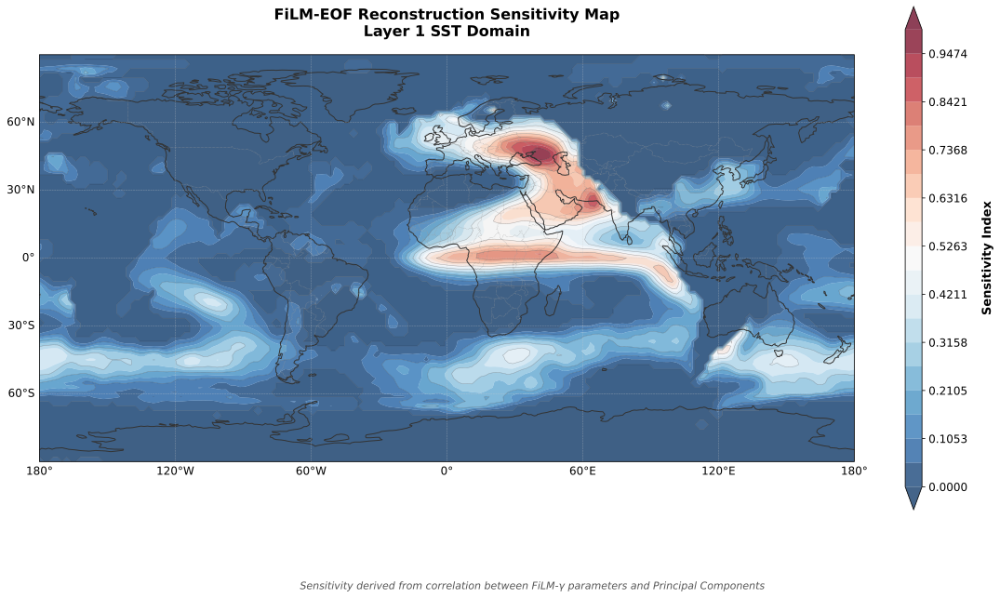

In [8]:
# 可视化FiLM-EOF重构敏感度图 - 叠加到世界地图上
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.patches as mpatches

# 首先尝试使用cartopy，如果失败则回退到imshow
try:
    # 假设敏感度图的地理范围是全球（-180 to 180，-90 to 90）
    # 如果实际范围不同，请根据数据调整
    
    fig = plt.figure(figsize=(16, 10), dpi=100)
    ax = plt.axes(projection=ccrs.PlateCarree())
    
    # 添加地球背景特征
    ax.add_feature(cfeature.LAND, facecolor='#f0f0f0', edgecolor='#cccccc', linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor='#e6f2ff', edgecolor='none')
    ax.add_feature(cfeature.COASTLINE, linewidth=1, color='#333333')
    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5, color='#999999')
    # 放大经纬标签字体
    gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, 
                linewidth=0.5, color='#cccccc', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    # 设置标签字体大小（比原先大一些）
    gl.xlabel_style = {'size': 12}
    gl.ylabel_style = {'size': 12}
    
    # 设置全球范围
    ax.set_global()
    
    # 绘制敏感度热力图 - 使用透明度以便看到地图
    H, W = sensitivity_map.shape
    # 假设数据覆盖全球范围
    lons = np.linspace(-180, 180, W)
    lats = np.linspace(-90, 90, H)
    lons_mesh, lats_mesh = np.meshgrid(lons, lats)
    
    # 绘制填充等高线
    levels = np.linspace(sensitivity_map.min(), sensitivity_map.max(), 20)
    contourf = ax.contourf(lons_mesh, lats_mesh, sensitivity_map, 
                           levels=levels, cmap='RdBu_r', 
                           transform=ccrs.PlateCarree(), 
                           alpha=0.75, extend='both')
    
    # 添加等高线边界（可选）
    contour = ax.contour(lons_mesh, lats_mesh, sensitivity_map, 
                         levels=levels[::2], colors='none',
                         transform=ccrs.PlateCarree(), linewidths=0.5, alpha=0.3)
    
    # 美化色条并放大字体
    cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.05, 
                       aspect=30, shrink=0.8)
    cbar.set_label('Sensitivity Index', fontsize=13, fontweight='bold', labelpad=15)
    cbar.ax.tick_params(labelsize=12)
    
    # 设置标题和标签（可适当增大）
    title = ax.set_title('FiLM-EOF Reconstruction Sensitivity Map\nLayer 1 SST Domain', 
                         fontsize=16, fontweight='bold', pad=20)
    
    # 添加底部文字说明
    fig.text(0.5, 0.02, 
            'Sensitivity derived from correlation between FiLM-γ parameters and Principal Components', 
            ha='center', fontsize=11, style='italic', color='#555555')
    
    plt.tight_layout(rect=[0, 0.03, 1, 1])
    plt.show()
    
except ImportError:
    print("⚠️ Cartopy not available. Using fallback visualization with matplotlib.")
    # 回退方案：更加学术化的imshow可视化（增大刻度与 colorbar 字体）
    fig, ax = plt.subplots(figsize=(14, 9), dpi=100)
    
    # 规范化数据到 [0, 1]
    im = ax.imshow(sensitivity_map, cmap='RdBu_r', aspect='auto', 
                   origin='upper', interpolation='bilinear')
    
    # 添加色条并放大字体
    cbar = plt.colorbar(im, ax=ax, orientation='vertical', pad=0.02, aspect=30)
    cbar.set_label('Sensitivity Index', fontsize=13, fontweight='bold', labelpad=15)
    cbar.ax.tick_params(labelsize=12)
    
    # 设置坐标轴标签（地理坐标）并增大字体
    H, W = sensitivity_map.shape
    lat_ticks = np.linspace(0, H-1, 7)
    lon_ticks = np.linspace(0, W-1, 13)
    
    ax.set_xticks(lon_ticks)
    ax.set_yticks(lat_ticks)
    ax.set_xticklabels([f'{int(x-180)}°' for x in np.linspace(0, 360, 13)], fontsize=12)
    ax.set_yticklabels([f'{int(y-90)}°' for y in np.linspace(-90, 90, 7)], fontsize=12)
    
    ax.set_xlabel('Longitude', fontsize=12, fontweight='bold')
    ax.set_ylabel('Latitude', fontsize=12, fontweight='bold')
    
    # 添加网格线
    ax.grid(True, linestyle='--', alpha=0.3, color='white', linewidth=0.5)
    
    # 设置标题
    ax.set_title('FiLM-EOF Reconstruction Sensitivity Map (Layer 1)\nSST Domain Spatial Distribution', 
                fontsize=15, fontweight='bold', pad=15)
    
    # 添加文本说明
    textstr = ('Spatial pattern of sensitivity derived from:\n'
              '• FiLM γ parameters from Layer 1\n'
              '• Correlation with SST Principal Components')
    ax.text(0.02, 0.98, textstr, transform=ax.transAxes, 
           fontsize=10, verticalalignment='top',
           bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))
    
    plt.tight_layout()
    plt.show()

In [9]:
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib import ticker

# -----------------------
# 多层敏感度对比分析 - 学术化可视化
# -----------------------
fig = plt.figure(figsize=(13, 10))
gs = gridspec.GridSpec(3, 2, figure=fig)

# 确保已经有 sensitivity_maps_by_layer 列表（每层为 HxW 数组）
sensitivity_maps_by_layer = []
for layer_idx in range(5):
    sens_map = reconstruct_sensitivity_map(corr_gamma[layer_idx], eof_patterns)
    sensitivity_maps_by_layer.append(sens_map)

# 统一 color range 便于比较（数据已经归一化到 0-1）
vmin, vmax = 0.0, 1.0
cmap = 'RdBu_r'

# 绘制每一层并在地图上叠加
axes = []
for idx in range(5):
    row = idx // 2
    col = idx % 2
    ax = fig.add_subplot(gs[row, col], projection=ccrs.PlateCarree())
    axes.append(ax)

    # 地图底图
    ax.set_global()
    ax.coastlines(resolution='110m', linewidth=0.8, color='#333333')
    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.6, edgecolor='#666666')
    ax.add_feature(cfeature.LAND, facecolor='#f7f7f7')
    ax.add_feature(cfeature.OCEAN, facecolor='#eaf4ff')

    # 网格线（只在边缘子图显示标签），并放大标签字体
    gl = ax.gridlines(draw_labels=True, linewidth=0.4, color='#bbbbbb', alpha=0.6, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    if col == 1:
        gl.left_labels = False
    if row != 2:
        gl.bottom_labels = False
    # 放大经纬标签字体
    gl.xlabel_style = {'size': 12}
    gl.ylabel_style = {'size': 12}

    # 准备经纬网格用于 contourf（假设 sens_map 为 H x W 并覆盖全球）
    sens_map = sensitivity_maps_by_layer[idx]
    H, W = sens_map.shape
    lons = np.linspace(0, 360, W)
    lats = np.linspace(-90, 90, H)
    lon_mesh, lat_mesh = np.meshgrid(lons, lats)

    # 绘制等值填色（带透明度）并限制取值范围
    cf = ax.contourf(lon_mesh, lat_mesh, sens_map, levels=40, cmap=cmap, vmin=vmin, vmax=vmax,
                     transform=ccrs.PlateCarree(), alpha=0.85, extend='both')

    # 标题和注释
    channel_count = corr_gamma[idx].shape[0]
    ax.set_title(f'Layer {idx+1} — {channel_count} channels', fontsize=14, fontweight='bold')

# 统一 colorbar（放置在右侧），并放大刻度字体
formatter = ticker.FormatStrFormatter('%.2f')
cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.7])  # [left, bottom, width, height]
cb = fig.colorbar(cf, cax=cbar_ax, orientation='vertical', format=formatter)
cb.set_label('Sensitivity (normalized)', fontsize=14, fontweight='bold')
cb.ax.tick_params(labelsize=12)

plt.tight_layout(rect=[0, 0.03, 0.92, 0.96])
plt.show()

# 备选回退（当 cartopy 不可用时）
# try/except 可在 notebook 顶端执行 import cartopy 时处理，或者将上面代码包在 try 中。

C:\Users\fired\AppData\Local\Temp\ipykernel_44224\4023324571.py:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 0.92, 0.96])


In [12]:
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
import shapely.geometry as sgeom
from matplotlib import ticker
import numpy as np
import matplotlib.pyplot as plt

# -----------------------
# 多层敏感度对比分析 - 学术化可视化
# -----------------------
fig = plt.figure(figsize=(13, 10))
gs = gridspec.GridSpec(3, 2, figure=fig)

# 确保已经有 sensitivity_maps_by_layer 列表（每层为 HxW 数组）
sensitivity_maps_by_layer = []
for layer_idx in range(5):
    sens_map = reconstruct_sensitivity_map(corr_gamma[layer_idx], eof_patterns)
    sensitivity_maps_by_layer.append(sens_map)

# 统一 color range 便于比较（数据已经归一化到 0-1）
vmin, vmax = 0.0, 1.0
cmap = 'RdBu_r'

# 创建一个陆地掩膜函数（处理-180到180经度范围）
def create_land_mask(lats, lons, resolution='110m'):
    """创建陆地掩膜，陆地为True，海洋为False"""
    # 获取陆地形状
    land_shp_fname = shapereader.natural_earth(resolution=resolution,
                                             category='physical',
                                             name='land')
    
    land_geom = []
    for record in shapereader.Reader(land_shp_fname).records():
        land_geom.append(record.geometry)
    
    # 创建掩膜网格
    mask = np.zeros((len(lats), len(lons)), dtype=bool)
    
    # 对每个网格点判断是否在陆地上
    for i, lat in enumerate(lats):
        for j, lon in enumerate(lons):
            point = sgeom.Point(lon, lat)
            for geom in land_geom:
                if geom.contains(point):
                    mask[i, j] = True
                    break
    return mask

# 绘制每一层并在地图上叠加
axes = []
for idx in range(5):
    row = idx // 2
    col = idx % 2
    ax = fig.add_subplot(gs[row, col], projection=ccrs.PlateCarree())
    axes.append(ax)

    # 地图底图
    ax.set_global()
    ax.coastlines(resolution='110m', linewidth=0.8, color='#333333')
    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.6, edgecolor='#666666')
    
    # 修改这里：将陆地改为纯白色，海洋改为浅蓝色
    ax.add_feature(cfeature.LAND, facecolor='white')  # 改为白色
    ax.add_feature(cfeature.OCEAN, facecolor='#eaf4ff')  # 保持浅蓝色

    # 网格线（只在边缘子图显示标签），并放大标签字体
    gl = ax.gridlines(draw_labels=True, linewidth=0.4, color='#bbbbbb', alpha=0.6, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    if col == 1:
        gl.left_labels = False
    if row != 2:
        gl.bottom_labels = False
    # 放大经纬标签字体
    gl.xlabel_style = {'size': 12}
    gl.ylabel_style = {'size': 12}

    # 准备经纬网格用于 contourf（假设 sens_map 为 H x W 并覆盖全球）
    sens_map = sensitivity_maps_by_layer[idx]
    H, W = sens_map.shape
    
    # 关键修改：使用-180到180的经度范围而不是0-360
    lons = np.linspace(-180, 180, W)
    lats = np.linspace(-90, 90, H)
    lon_mesh, lat_mesh = np.meshgrid(lons, lats)

    # 关键修改：创建陆地掩膜并将陆地上的敏感度值设为NaN
    if idx == 0:  # 只为第一层创建掩膜（假设所有层网格相同）
        land_mask = create_land_mask(lats, lons)
    
    # 复制敏感度数据并将陆地区域设为NaN
    sens_map_masked = sens_map.copy()
    sens_map_masked[land_mask] = np.nan

    # 绘制等值填色（带透明度）并限制取值范围
    # 使用掩膜后的数据，这样陆地上就不会显示颜色
    cf = ax.contourf(lon_mesh, lat_mesh, sens_map_masked, levels=40, cmap=cmap, vmin=vmin, vmax=vmax,
                     transform=ccrs.PlateCarree(), alpha=0.85, extend='both')

    # 标题和注释
    channel_count = corr_gamma[idx].shape[0]
    ax.set_title(f'Layer {idx+1} — {channel_count} channels', fontsize=14, fontweight='bold')

# 统一 colorbar（放置在右侧），并放大刻度字体
formatter = ticker.FormatStrFormatter('%.2f')
cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.7])  # [left, bottom, width, height]
cb = fig.colorbar(cf, cax=cbar_ax, orientation='vertical', format=formatter)
cb.set_label('Sensitivity (normalized)', fontsize=14, fontweight='bold')
cb.ax.tick_params(labelsize=12)

plt.tight_layout(rect=[0, 0.03, 0.92, 0.96])
plt.show()

C:\Users\fired\AppData\Local\Temp\ipykernel_44224\3128331829.py:113: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 0.92, 0.96])


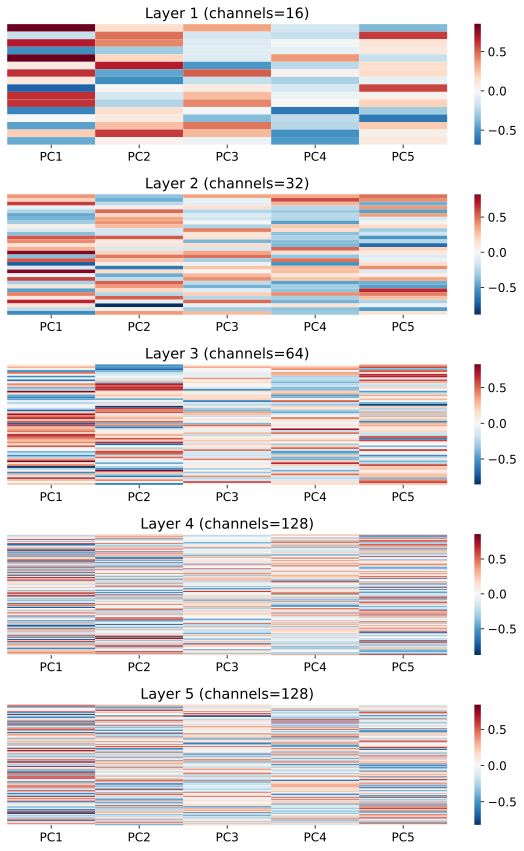

In [10]:
#方法4：分层图
import matplotlib.pyplot as plt
import seaborn as sns

fig, axes = plt.subplots(5, 1, figsize=(8, 12))
for i, (g, ax) in enumerate(zip(gamma_per_layer, axes)):
    corr = np.zeros((g.shape[1], pcs.shape[1]))
    for c in range(g.shape[1]):
        for j in range(pcs.shape[1]):
            corr[c, j] = pearsonr(g[:, c], pcs[0:345, j])[0]
    sns.heatmap(corr, ax=ax, cmap='RdBu_r', center=0,
                xticklabels=[f'PC{j+1}' for j in range(pcs.shape[1])],
                yticklabels=False)
    ax.set_title(f'Layer {i+1} (channels={g.shape[1]})')
plt.tight_layout()
plt.show()


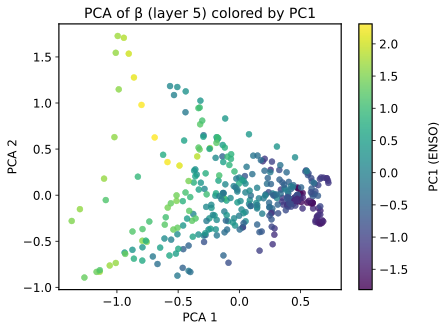

In [18]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import numpy as np

# 假设你的原始数据还在
# gamma_per_layer[4].shape = (345, 128)
# pcs.shape 至少是 (345, n)，我们只用第一主成分 pcs[:, 0]

pca = PCA(n_components=2)
proj = pca.fit_transform(beta_per_layer[4])   # (345, 2)

pc1_values = pcs[0:345, 0]                     # 用于着色和设置点大小的关键向量

# 归一化到合适的大小范围（你可以微调 100~800 这个区间）
# sizes = (pc1_values - pc1_values.min()) / (np.ptp(pc1_values)) * 700 + 100

fig, ax = plt.subplots()

scatter = ax.scatter(proj[:, 0], proj[:, 1],
                     c=pc1_values,
                    #  s=sizes,
                     cmap='viridis',       # 目标图就是 viridis
                     alpha=0.8,
                    #  edgecolor='k',        # 黑色边缘，显著提升可读性
                     linewidth=0.5)

# colorbar 美化
cbar = plt.colorbar(scatter, ax=ax)
cbar.set_label('PC1 (ENSO)', labelpad=20, fontsize=12)

ax.set_xlabel('PCA 1', fontsize=12)
ax.set_ylabel('PCA 2', fontsize=12)
ax.set_title('PCA of β (layer 5) colored by PC1', fontsize=14)

# 和原图几乎一致的坐标轴范围（包括留白）
# ax.set_xlim(-0.8, 1.35)
# ax.set_ylim(-0.6, 1.65)

# 可选：去掉上侧和右侧边框，更清爽
# ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


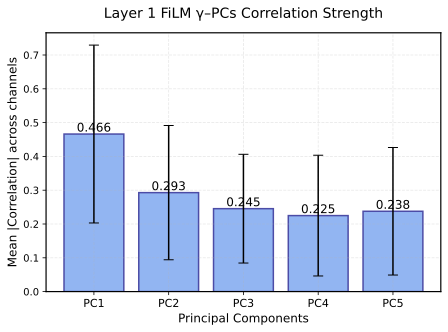

In [21]:
# 方法1平均值
layer = 0
mean_corr = np.mean(np.abs(corr_gamma[layer]), axis=0)
std_corr = np.std(np.abs(corr_gamma[layer]), axis=0)

# 设置图形风格和大小
# plt.style.use('seaborn')
# plt.figure(figsize=(10, 6))

# 创建条形图
bars = plt.bar(range(1,6), mean_corr, yerr=std_corr, capsize=5, 
               color='cornflowerblue', alpha=0.7, 
               edgecolor='navy', linewidth=1.5)

# 添加数值标签
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{height:.3f}',
             ha='center', va='bottom')

# 自定义坐标轴
plt.xticks(range(1,6), [f'PC{j}' for j in range(1,6)], fontsize=11)
plt.yticks(fontsize=10)

# 添加标签和标题
plt.ylabel("Mean |Correlation| across channels", fontsize=12)
plt.xlabel("Principal Components", fontsize=12)
plt.title(f"Layer {layer+1} FiLM γ–PCs Correlation Strength", 
          fontsize=14, pad=15)

# 添加网格线
plt.grid(True, linestyle='--', alpha=0.3)

# 调整布局
plt.tight_layout()

plt.show()

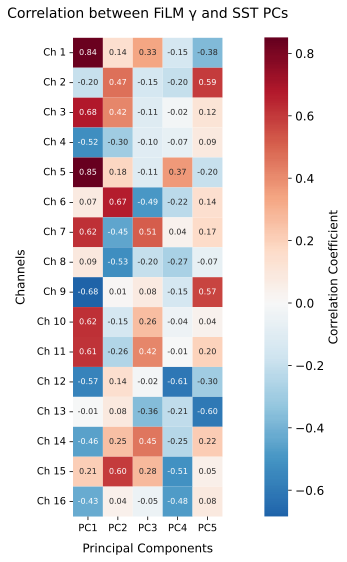

In [27]:
# 设置图形大小
plt.figure(figsize=(12, 8))

# 创建自定义标签
channel_labels = [f'Ch {i+1}' for i in range(corr_beta[0].shape[0])]
pc_labels = [f'PC{j+1}' for j in range(corr_beta[0].shape[1])]

# 创建热图
sns.heatmap(corr_gamma[0], 
            annot=True,              # 显示数值
            fmt=".2f",              # 数值格式化为2位小数
            cmap="RdBu_r",         # 使用红蓝配色方案
            center=0,               # 将颜色中心点设为0
            square=True,           # 保持单元格为正方形
            xticklabels=pc_labels,
            yticklabels=channel_labels,
            cbar_kws={'label': 'Correlation Coefficient'},  # 添加颜色条标签
            annot_kws={'size': 8})  # 调整数字标注大小

# 设置标题和标签
plt.title("Correlation between FiLM γ and SST PCs", 
         fontsize=14, pad=20)
plt.xlabel("Principal Components", fontsize=12, labelpad=10)
plt.ylabel("Channels", fontsize=12, labelpad=10)

# 调整刻度标签方向和大小
plt.xticks(rotation=0, fontsize=10)
plt.yticks(rotation=0, fontsize=10)

# 调整布局
plt.tight_layout()

plt.show()

In [ ]:
# 这是什么东西

In [16]:
#Unet3的CAM图
target_layer = model.outc.conv  # 或 model.up4.conv.double_conv[-1]

features = []
gradients = []

def forward_hook(module, input, output):
    features.append(output)

def backward_hook(module, grad_in, grad_out):
    gradients.append(grad_out[0])

target_layer.register_forward_hook(forward_hook)
target_layer.register_backward_hook(backward_hook)

model.eval()
cmas = []
grad_witch = 10
for i in range(train_set.__len__()):
    x_0, cond, mask, pcs = train_set[grad_witch:grad_witch+1]
    x_0, cond, mask, pcs = (
        x_0.to(device),
        cond.to(device),
        mask.to(device),
        pcs.to(device),
    )
    output = model(cond, pcs)

    # 选择目标输出 y^k
    target = output.mean()  # 或 output[0,0,y,x] 针对特定格点

    # 清空梯度
    model.zero_grad()
    target.backward()  # 计算梯度

    grads = gradients[0]                # [C,H,W]
    acts = features[0]                  # [C,H,W]
    weights = torch.mean(grads, dim=(1,2))  # [C]
    cam = torch.sum(weights[:, None, None] * acts, dim=0)  # [H,W]
    cam = F.relu(cam)  # 只保留正相关
    cam = cam - cam.min()
    cam = cam / (cam.max() + 1e-8)
    cam = cam.squeeze().cpu().detach().numpy()
    cmas.append(cam)

mean_cam = np.mean(cmas, axis=0)
fucs.draw_rainfall_map(mean_cam+1e-6, color_mode='red')


f:\Anaconda\envs\nc\Lib\site-packages\torch\nn\modules\module.py:1864: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


In [3]:
#unet3 原本的推理过程
output_list = []
x0_list = []
with torch.no_grad():
    for x_0, cond, mask, pcs in tqdm.tqdm(train_loader):
        x_0, cond, mask, pcs = x_0.to(device), cond.to(device), mask.to(device), pcs.to(device)
        output = model(cond, pcs)
        output[mask] = float('nan')
        output_list.append(output)
        x0_list.append(x_0)

with torch.no_grad():
    for x_0, cond, mask, pcs in tqdm.tqdm(test_loader):
        x_0, cond, mask, pcs = x_0.to(device), cond.to(device), mask.to(device), pcs.to(device)
        output = model(cond, pcs)
        output[mask] = float('nan')
        output_list.append(output)
        x0_list.append(x_0)

output_all = torch.cat(output_list, dim=0)
x0_all = torch.cat(x0_list, dim=0)
acc = fucs.cal_acc(torch.tensor(x0_all).squeeze(1), torch.tensor(output_all).squeeze(1))
print(acc[0:345].mean(),acc[345:366].mean())


  0%|          | 0/22 [00:00<?, ?it/s]


RuntimeError: Given groups=1, weight of size [16, 10, 3, 3], expected input[16, 60, 120, 140] to have 10 channels, but got 60 channels instead

In [ ]:
np.save(r'E:\D1\diffusion\my_models\my_model_data\u-net3.npy', output_all.cpu().numpy())

#### 评估UNet2

In [10]:
train_set, test_set = prepare_data2()

train_loader = DataLoader(
    train_set, batch_size=config.modelconfig["batch_size"],
    shuffle=False, num_workers=0, pin_memory=True
)
test_loader = DataLoader(
    test_set, batch_size=config.modelconfig["batch_size"],
    shuffle=False, num_workers=0, pin_memory=True
)

input_channels = train_set[0][1].shape[0]  # condition channels
# index_dim = train_set[0][3].shape[0]       # PCs dimension (n_pcs * window)

with torch.no_grad():
    device = torch.device(config.modelconfig['device'])
    model = UNetLite(
        n_channels=input_channels,
        n_classes=1,
        # index_dim=index_dim,
        base_filters=32,
        dropout=0.2
    ).to(device)
    ckpt = torch.load(
        os.path.join("E:/D1\diffusion/my_models/UNet_data/train_weight_unet2", "unet_100.pt"),
        map_location=device
    )
    model.load_state_dict(ckpt)
    model.to(device)
    model.eval()

<>:25: SyntaxWarning: invalid escape sequence '\d'
<>:25: SyntaxWarning: invalid escape sequence '\d'
C:\Users\fired\AppData\Local\Temp\ipykernel_28912\1882171733.py:25: SyntaxWarning: invalid escape sequence '\d'
  os.path.join("E:/D1\diffusion/my_models/UNet_data/train_weight_unet2", "unet_100.pt"),


Loaded SST shape: (366, 6, 89, 180)
Averaged over month-dim: (366, 89, 180)
PCA done. 10 PCs explain 0.712 variance.


e:\D1\diffusion\my_models\my_model\Unet2.py:22: RuntimeWarning: Mean of empty slice
  sst_mean = np.nanmean(sst, axis=0, keepdims=True)


In [13]:
#Unet2的CAM图 1把model设置为模型2，
target_layer = model.outc.conv  # 或 model.up4.conv.double_conv[-1]

features = []
gradients = []

def forward_hook(module, input, output):
    features.append(output)

def backward_hook(module, grad_in, grad_out):
    gradients.append(grad_out[0])

target_layer.register_forward_hook(forward_hook)
target_layer.register_backward_hook(backward_hook)

model.eval()
cmas = []
grad_witch = 10
for i in range(train_set.__len__()):
    x_0, cond, mask= train_set[grad_witch:grad_witch+1]
    x_0, cond, mask = (
        x_0.to(device),
        cond.to(device),
        mask.to(device),
    )
    cond[:,10:20] = torch.zeros_like(cond[:,10:20])
    # cond[:,0:10] = torch.zeros_like(cond[:,0:10])
    output = model(cond)

    # 选择目标输出 y^k
    target = output.mean()  # 或 output[0,0,y,x] 针对特定格点
    # target = output[0,0,64,64]   # 指定某个网格，不能用mean()


    # 清空梯度
    model.zero_grad()
    target.backward()  # 计算梯度

    grads = gradients[0]                # [C,H,W]
    acts = features[0]                  # [C,H,W]
    weights = torch.mean(grads, dim=(1,2))  # [C]
    cam = torch.sum(weights[:, None, None] * acts, dim=0)  # [H,W]
    cam = F.relu(cam)  # 只保留正相关
    cam = cam - cam.min()
    cam = cam / (cam.max() + 1e-8)
    cam = cam.squeeze().cpu().detach().numpy()
    cmas.append(cam)

mean_cam = np.mean(cmas, axis=0)
fucs.draw_rainfall_map(mean_cam+1e-6, color_mode='red')

f:\Anaconda\envs\nc\Lib\site-packages\torch\nn\modules\module.py:1864: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


In [5]:
for i in range(cond.shape[1]):
    print(cond[0,i].mean())

tensor(-0.0217, device='cuda:0')
tensor(0.2834, device='cuda:0')
tensor(0.4885, device='cuda:0')
tensor(0.0271, device='cuda:0')
tensor(0.2458, device='cuda:0')
tensor(0.1975, device='cuda:0')
tensor(-0.1966, device='cuda:0')
tensor(-0.2349, device='cuda:0')
tensor(-0.0784, device='cuda:0')
tensor(-0.0388, device='cuda:0')
tensor(-0.6847, device='cuda:0')
tensor(1.2177, device='cuda:0')
tensor(1.0062, device='cuda:0')
tensor(-0.2768, device='cuda:0')
tensor(0.9744, device='cuda:0')
tensor(-1.6233, device='cuda:0')
tensor(1.0958, device='cuda:0')
tensor(-1.4654, device='cuda:0')
tensor(-1.5803, device='cuda:0')
tensor(0.1960, device='cuda:0')


In [ ]:
#unet2
output_list = []
x0_list = []
for x_0, cond, mask in tqdm.tqdm(train_loader):
    x_0, cond, mask = x_0.to(device), cond.to(device), mask.to(device)
    out = model(cond)
    out[mask] = float("nan")
    output_list.append(out)
    x0_list.append(x_0)

for x_0, cond, mask in tqdm.tqdm(test_loader):
    x_0, cond, mask = x_0.to(device), cond.to(device), mask.to(device)
    out = model(cond)
    out[mask] = float("nan")
    output_list.append(out)
    x0_list.append(x_0)

output_all = torch.cat(output_list, dim=0)
x0_all = torch.cat(x0_list, dim=0)
acc = fucs.cal_acc(torch.tensor(x0_all).squeeze(1), torch.tensor(output_all).squeeze(1))
print(acc[0:345].mean(),acc[345:366].mean())



In [ ]:
np.save(r'E:\D1\diffusion\my_models\my_model_data\u-net2.npy', output_all.detach().cpu().numpy())

#### 评估UNet1

In [ ]:
from Unet_train import npy_dataset

device = torch.device(config.modelconfig["device"])
target_file_dir = config.modelconfig["hr_path"]

target_data = target_file_dir+'/hr_data1.npy'
target_data = torch.tensor(np.load(target_data), dtype=torch.float32)
target_data = torch.unsqueeze(target_data, dim=1)
# target_data = target_data.view(-1, 1, 120, 140)#51786,1,32,32
data_mask = torch.isnan(target_data)

model_file_dir = config.modelconfig["lr_path"]
model_data = np.load(model_file_dir+'/lr_data1.npy')
condition = torch.tensor(model_data)#189,274,10,32,32
# condition = condition.view(-1, 10, 120, 140)#51786,10,32,32

# ============= 修改：直接在展平后的数据上分割测试集 =============
num_test_samples = 21  

# 计算训练集和测试集的索引范围
total_samples = len(target_data)
train_end_idx = total_samples - num_test_samples

# 创建训练集
train_target_data = target_data[:train_end_idx]
train_condition = condition[:train_end_idx]
train_mask = data_mask[:train_end_idx]

test_target_data = target_data[train_end_idx:]
test_condition = condition[train_end_idx:]
test_mask = data_mask[train_end_idx:]

print(f"Total samples: {total_samples}")
print(f"Training samples: {len(train_target_data)}, Testing samples: {len(test_target_data)}")

# 创建数据集
train_dataset = npy_dataset(train_target_data, train_condition, train_mask)
test_dataset = npy_dataset(test_target_data, test_condition, test_mask)

train_dataloader = torch.utils.data.DataLoader(
    dataset=train_dataset,
    batch_size=config.modelconfig["batch_size"],
    shuffle=False,
    num_workers=4,
    drop_last=False,
    pin_memory=True
)

test_dataloader = torch.utils.data.DataLoader(
    dataset=test_dataset,
    batch_size=config.modelconfig["batch_size"],
    shuffle=False,  # 测试集不需要shuffle
    num_workers=2,
    pin_memory=True
)


device = torch.device(config.modelconfig['device'])
model = UNetLite(
    n_channels=10,
    n_classes=1,
    # index_dim=index_dim,
    base_filters=32,
    dropout=0.2
).to(device)
ckpt = torch.load(
    os.path.join("E:/D1/diffusion/my_models/UNet_data/train_weight_unet1", "unet_40.pt"),
    map_location=device
)
model.load_state_dict(ckpt)
model.to(device)
model.eval()

In [15]:
target_layer = model.outc.conv  # 或 model.up4.conv.double_conv[-1]

features = []
gradients = []

def forward_hook(module, input, output):
    features.append(output)

def backward_hook(module, grad_in, grad_out):
    gradients.append(grad_out[0])

target_layer.register_forward_hook(forward_hook)
target_layer.register_backward_hook(backward_hook)

model.eval()
cmas = []
grad_witch = 10
for i in range(train_dataset.__len__()):
    x_0, cond, mask= train_dataset[grad_witch:grad_witch+1]
    x_0, cond, mask = (
        x_0.to(device),
        cond.to(device),
        mask.to(device),
    )
    output = model(cond)

    # 选择目标输出 y^k
    target = output.mean()  # 或 output[0,0,y,x] 针对特定格点

    # 清空梯度
    model.zero_grad()
    target.backward()  # 计算梯度

    grads = gradients[0]                # [C,H,W]
    acts = features[0]                  # [C,H,W]
    weights = torch.mean(grads, dim=(1,2))  # [C]
    cam = torch.sum(weights[:, None, None] * acts, dim=0)  # [H,W]
    cam = F.relu(cam)  # 只保留正相关
    cam = cam - cam.min()
    cam = cam / (cam.max() + 1e-8)
    cam = cam.squeeze().cpu().detach().numpy()
    cmas.append(cam)

mean_cam = np.mean(cmas, axis=0)
fucs.draw_rainfall_map(mean_cam+1e-6, color_mode='red')

f:\Anaconda\envs\nc\Lib\site-packages\torch\nn\modules\module.py:1864: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


In [ ]:
# ===========================================================
output_list = []
x0_list = []

best_test_loss = float('inf')  # 记录最佳测试损失

for step, (x_0, condition, mask) in enumerate(tqdm.tqdm(train_dataloader, dynamic_ncols=True)):
    x_0 = x_0.to(device, non_blocking=True)
    mask = mask.to(device, non_blocking=True)
    condition = condition.to(device, non_blocking=True)
    # 前向传播得到模型输出
    output = model(condition)
    output[mask] = float('nan')
    output_list.append(output)
    x0_list.append(x_0)

for step, (x_0, condition, mask) in enumerate(tqdm.tqdm(test_dataloader, dynamic_ncols=True)):
    x_0 = x_0.to(device, non_blocking=True)
    mask = mask.to(device, non_blocking=True)
    condition = condition.to(device, non_blocking=True)
    # 前向传播得到模型输出
    output = model(condition)
    output[mask] = float('nan')
    output_list.append(output)
    x0_list.append(x_0)
    
output_all = torch.cat(output_list, dim=0)
x0_all = torch.cat(x0_list, dim=0)
acc = fucs.cal_acc(torch.tensor(x0_all).squeeze(1), torch.tensor(output_all).squeeze(1))
print(acc[0:345].mean(),acc[345:366].nanmean())

In [ ]:
np.save(r'E:\D1\diffusion\my_models\my_model_data\u-net1.npy', output_all.cpu().detach().numpy())